In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, random_split
from torchvision import transforms
import torchvision.models as models
from torchvision.datasets import ImageFolder
import matplotlib.pyplot as plt
import torchvision.datasets as datasets
from PIL import Image
import numpy as np
import random

In [3]:
data_directory = '/kaggle/input/kaggle-cat-vs-dog-dataset/kagglecatsanddogs_3367a/PetImages'

import urllib.request


url = 'https://raw.githubusercontent.com/pytorch/hub/master/imagenet_classes.txt'
class_list = urllib.request.urlopen(url).read().decode('utf-8').splitlines()
imagenet_dict = {i: label for i, label in enumerate(class_list)}


In [3]:
class CatDogDataset(Dataset):
    def __init__(self, data_dir, transform=None):
        self.data = ImageFolder(data_dir, transform=transform)

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        return self.data[idx]

    @property
    def classes(self):
        return self.data.classes

In [4]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(
        mean=[0.485, 0.456, 0.406],  
        std=[0.229, 0.224, 0.225]   
    )
])

def denormalize(tensor):
    mean = [0.485, 0.456, 0.406]
    std = [0.229, 0.224, 0.225]
    mean = torch.tensor(mean).view(-1, 1, 1)
    std = torch.tensor(std).view(-1, 1, 1)
    return tensor * std + mean


dataset = CatDogDataset(data_directory,transform)

In [6]:
resnet50 = models.resnet50(weights = models.ResNet50_Weights.DEFAULT)
resnet50.cuda()
resnet50.eval()

target_layer = resnet50.layer4[-1].conv3

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 216MB/s]


In [83]:
def grad_cam(resnet50, target_layer, image_tensor, target_class = None):
    hook_values = {'activations': None, 'gradients': None}
    
    def forward_hook(module, input, output):
        hook_values['activations'] = output.detach()
    
    def backward_hook(module, grad_input, grad_output):
        hook_values['gradients'] = grad_output[0].detach()

    fwd_handle = target_layer.register_forward_hook(forward_hook)
    bwd_handle = target_layer.register_backward_hook(backward_hook)

    output = resnet50(image_tensor)
    if target_class == None:
        target_class = output.argmax().item()
    loss = output[0, target_class]

    resnet50.zero_grad()
    loss.backward()

    fwd_handle.remove()
    bwd_handle.remove()

    activations = hook_values['activations']
    gradients = hook_values['gradients']

    weights = gradients.mean(dim=(2, 3), keepdim=True)
    cam = (weights * activations).sum(dim=1, keepdim=True)
    cam = F.relu(cam)

    cam = cam.squeeze()
    cam -= cam.min()
    cam /= cam.max()
    
    cam = cam.unsqueeze(0).unsqueeze(0)  
    cam_resized = F.interpolate(cam, size=(224, 224), mode='bilinear', align_corners=False)
    cam_resized = cam_resized.squeeze().cpu().numpy()
    
    return cam_resized, target_class

Guided backprop

In [24]:
class GuidedReLU(torch.autograd.Function):
    @staticmethod
    def forward(ctx, input):
        ctx.save_for_backward(input)
        return input.clamp(min=0)

    @staticmethod
    def backward(ctx, grad_output):
        input, = ctx.saved_tensors
        grad_input = grad_output.clone()
        grad_input[input < 0] = 0
        grad_input[grad_output < 0] = 0
        return grad_input

class GuidedReLUWrapper(nn.Module):
    def forward(self, x):
        return GuidedReLU.apply(x)

def replace_relu_with_guidedrelu(module):
    for name, mod in module.named_children():
        if isinstance(mod, nn.ReLU):
            setattr(module, name, GuidedReLUWrapper())
        else:
            replace_relu_with_guidedrelu(mod)

In [29]:
def guided_backprop(resnet50, image_tensor):
    replace_relu_with_guidedrelu(resnet50)
    image_tensor.requires_grad = True
    
    output = resnet50(image_tensor)
    target_class = output.argmax().item()
    loss = output[0, target_class]
    
    resnet50.zero_grad()
    loss.backward()

    guided_gradients = input_tensor.grad.data[0].cpu().numpy()
    guided_gradients = np.sum(np.abs(guided_gradients), axis=0)
    guided_gradients -= guided_gradients.min()
    guided_gradients /= guided_gradients.max()

    return guided_gradients, target_class

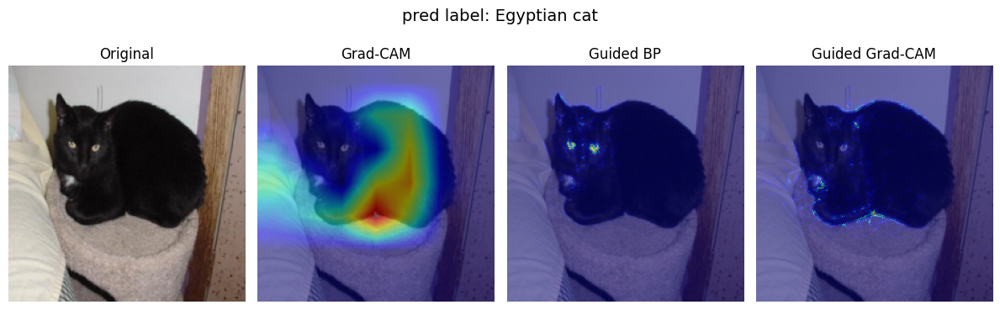

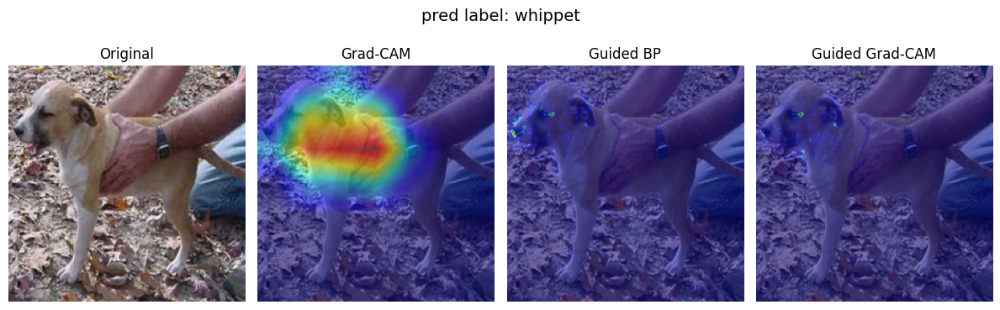

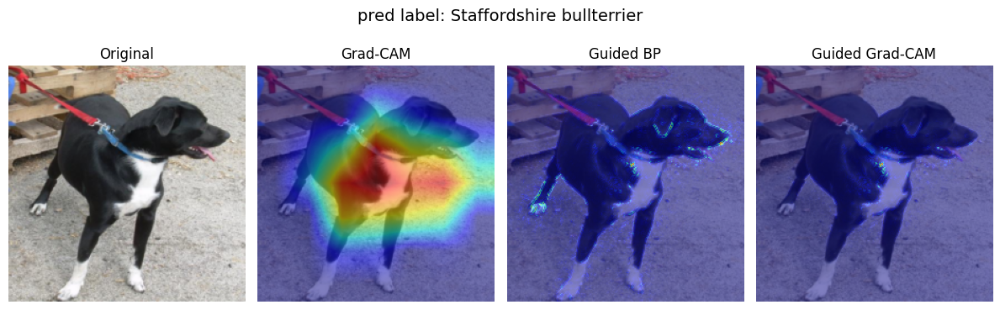

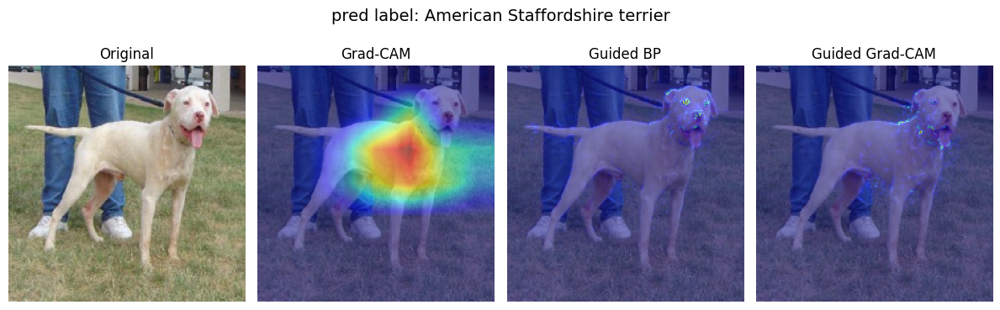

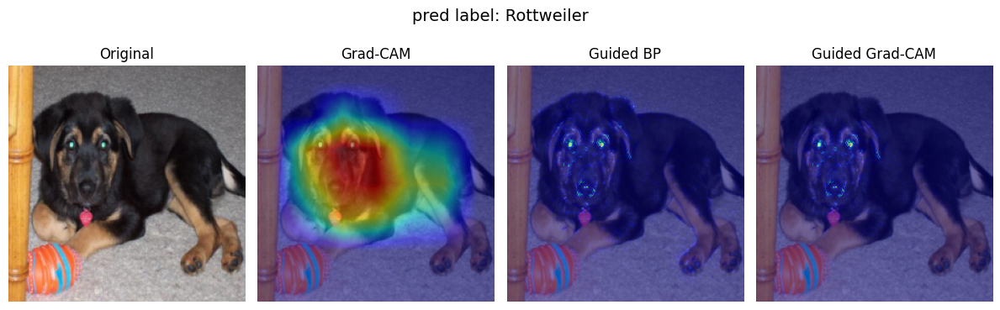

In [33]:
num_images = 5 

for i in range(num_images):
    idx = random.randint(0, len(dataset) - 1)
    input_tensor, label = dataset[idx]
    input_tensor = input_tensor.unsqueeze(0).cuda()
    orig = transforms.ToPILImage()(denormalize(dataset[idx][0]).cpu())  

    
    resnet50 = models.resnet50(weights = models.ResNet50_Weights.DEFAULT)
    target_layer = resnet50.layer4[-1].conv3
    resnet50.cuda()
    resnet50.eval()
    
    cam, _ = grad_cam(resnet50, target_layer, input_tensor) 
    guided_bp, target_class = guided_backprop(resnet50, input_tensor)  
    guided_gradcam = guided_bp * cam  

    guided_gradcam -= guided_gradcam.min()
    guided_gradcam /= guided_gradcam.max()


    plt.figure(figsize=(12, 4))
    plt.subplot(1, 4, 1)
    plt.imshow(orig)
    plt.title("Original")
    plt.axis("off")

    plt.subplot(1, 4, 2)
    plt.imshow(orig)
    plt.imshow(cam, cmap='jet', alpha = 0.5)
    plt.title("Grad-CAM")
    plt.axis("off")

    plt.subplot(1, 4, 3)
    plt.imshow(orig)
    plt.imshow(guided_bp, cmap='jet', alpha = 0.5)
    plt.title("Guided BP")
    plt.axis("off")

    plt.subplot(1, 4, 4)
    plt.imshow(orig)
    plt.imshow(guided_gradcam, cmap='jet', alpha = 0.5)
    plt.title("Guided Grad-CAM")
    plt.axis("off")

    plt.suptitle(f"pred label: {imagenet_dict[target_class]}", fontsize=14)
    plt.tight_layout()
    plt.show()


In [76]:
def extract_feature_maps(resnet50, image_tensor):
    feature_maps = {}
    def hook_fn(module, input, output):
        feature_maps['maps'] = output.detach().cpu()

    target_layer = resnet50.layer3[-1].conv3
    hook = target_layer.register_forward_hook(hook_fn)
    
    _ = resnet50(image_tensor)
    
    hook.remove()
    
    results = feature_maps['maps'][0]
    return results

def visualize_feature_maps(feature_maps, original_img, num_maps=19):
    num_channels = feature_maps.shape[0]

    original_img = transforms.ToPILImage()(denormalize(original_img).cpu())  

    plt.figure(figsize=(20, 15))

    plt.subplot(4, 5, 1)
    plt.imshow(original_img)
    plt.title("Original Image")
    plt.axis('off')
    
    
    for i in range(num_maps):
        plt.subplot(4, 5, i+2)
        fp = feature_maps[i+30]
        fp = fp.unsqueeze(0).unsqueeze(0)  
        fp_resized = F.interpolate(fp, size=(224, 224), mode='bilinear', align_corners=False)
        plt.imshow(original_img)
        plt.imshow(fp_resized.squeeze().cpu().numpy(), cmap='jet', alpha = 0.5)
        plt.title(f"Channel {i + 30}")
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

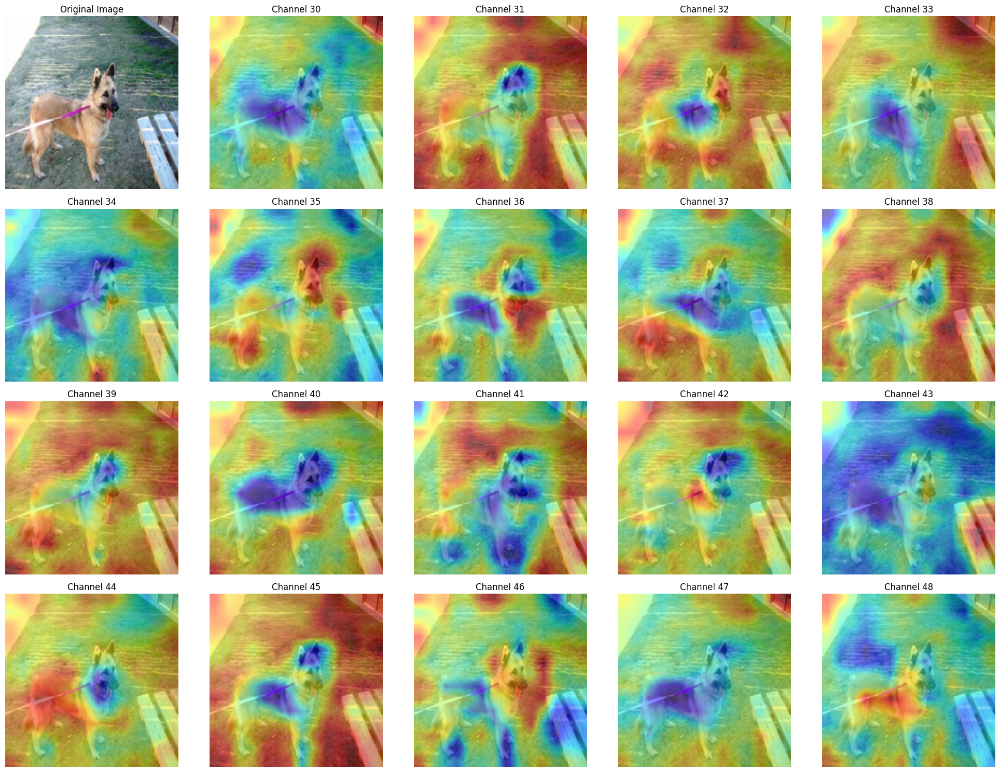

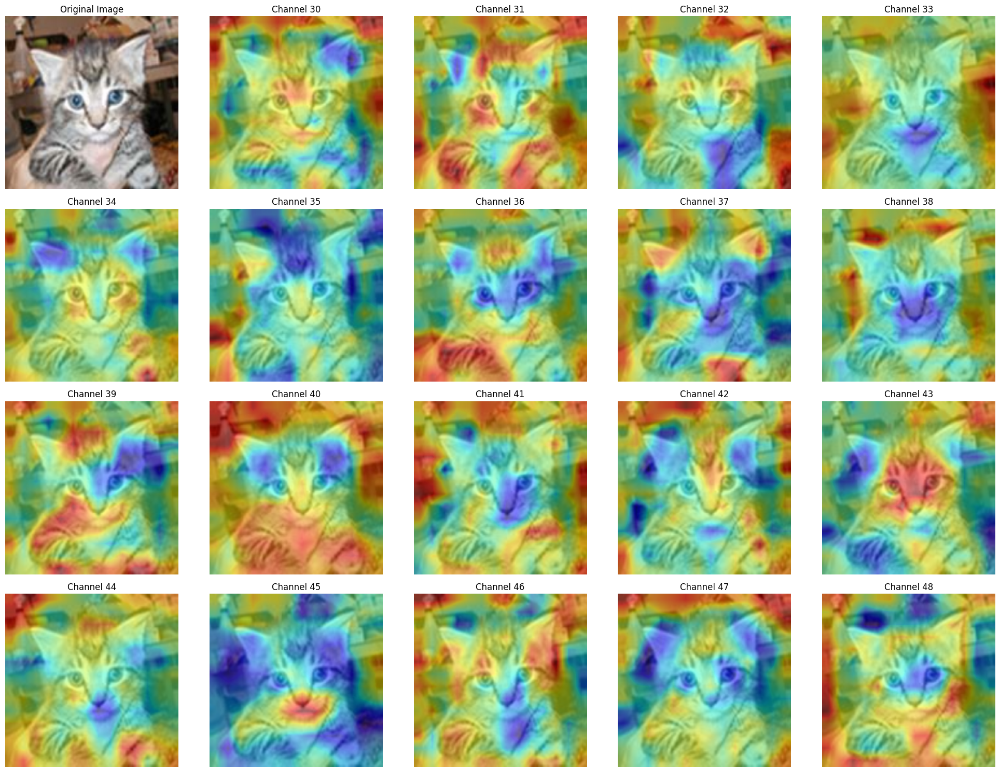

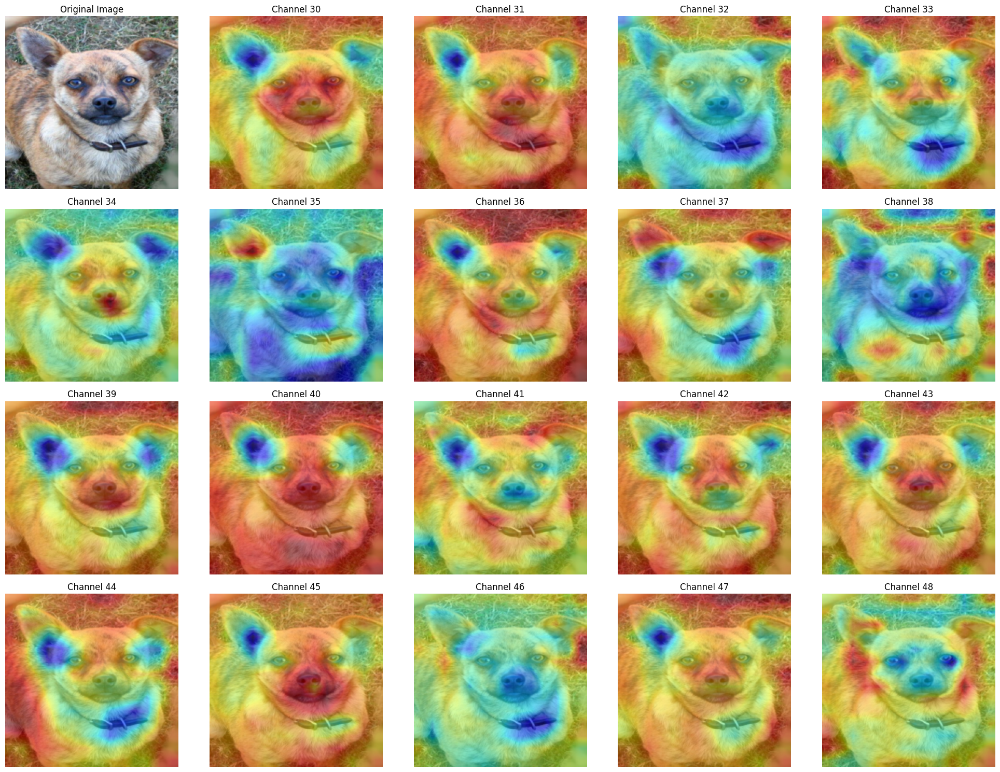

In [ ]:
resnet50 = models.resnet50(weights = models.ResNet50_Weights.DEFAULT)
resnet50.cuda()
resnet50.eval()
for i in range(4):
    idx = random.randint(0, len(dataset)-1)
    feature_maps = extract_feature_maps(resnet50, dataset[idx][0].unsqueeze(0).cuda())
    visualize_feature_maps(feature_maps, dataset[idx][0])

In [5]:
import kagglehub
path = kagglehub.dataset_download("sautkin/imagenet1k0")
print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/imagenet1k0


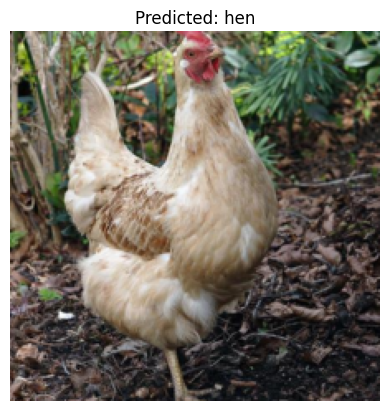

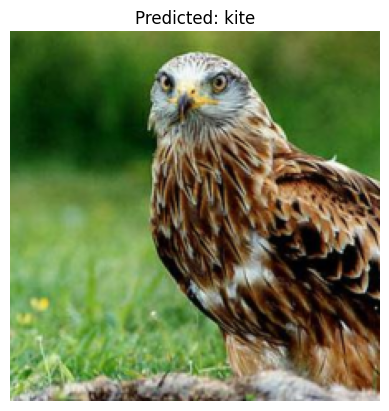

In [17]:
model = models.vgg16(weights=models.VGG16_Weights.DEFAULT).cuda()
model.eval()

transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

inv_normalize = transforms.Normalize(
    mean=[-0.485/0.229, -0.456/0.224, -0.406/0.225],
    std=[1/0.229, 1/0.224, 1/0.225]
)


image_paths = [
    "/kaggle/input/imagenet1k0/00008/017925860328703.jpg",
    "/kaggle/input/imagenet1k0/00021/010928788793284.jpg"
]


for path in image_paths:
    img = Image.open(path).convert('RGB')
    input_tensor = transform(img).unsqueeze(0).cuda()

    with torch.no_grad():
        output = model(input_tensor)
        pred_idx = torch.argmax(output[0]).item()
        pred_label = imagenet_dict[pred_idx]

    img_to_show = inv_normalize(input_tensor[0]).cpu().permute(1, 2, 0).clamp(0, 1)
    plt.imshow(img_to_show)
    plt.title(f"Predicted: {pred_label}")
    plt.axis('off')
    plt.show()


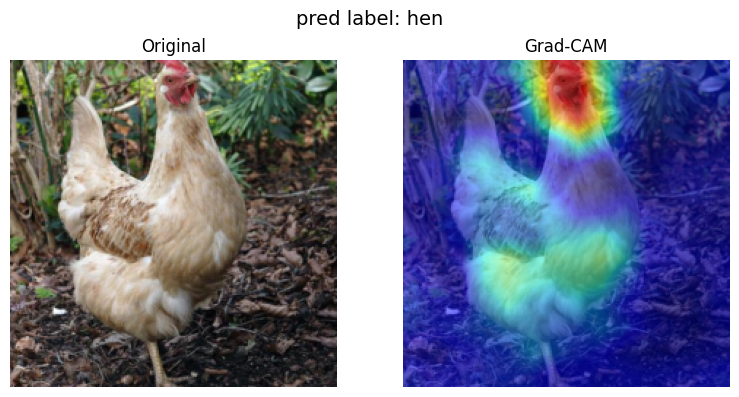

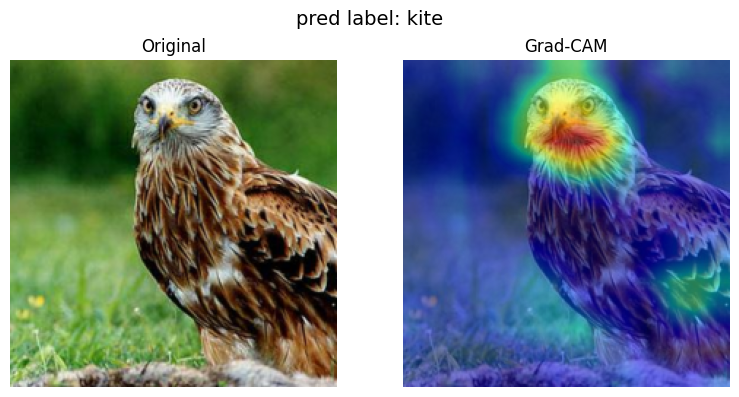

In [75]:
target_layer = model.features[29]

for path in image_paths:
    img = Image.open(path).convert('RGB')
    input_tensor = transform(img).unsqueeze(0).cuda()
    orig = inv_normalize(input_tensor[0]).cpu().permute(1, 2, 0).clamp(0, 1)
    
    cam, target_class = grad_cam(model, target_layer, input_tensor) 
    plt.figure(figsize=(8, 4))
    plt.subplot(1, 2, 1)
    plt.imshow(orig)
    plt.title("Original")
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.imshow(orig)
    plt.imshow(cam, cmap='jet', alpha = 0.5)
    plt.title("Grad-CAM")
    plt.axis("off")
    plt.suptitle(f"pred label: {imagenet_dict[target_class]}", fontsize=14)
    plt.tight_layout()
    plt.show()

In [60]:
def ps(epsilon, original_image, perturbed_image):
    perturbation = torch.clamp(perturbed_image - original_image, -epsilon, epsilon)
    perturbed_image = original_image + perturbation
    
    perturbed_image = torch.clamp(perturbed_image, 0, 1)
    noise = (perturbed_image - original_image)
    return perturbed_image, noise


def pgd_attack(model, images, labels, epsilon, alpha, pgd_iter):
    images, labels = images.cuda(), labels.cuda()
    perturbed_images = images.clone().detach()
    
    for _ in range(pgd_iter):
        perturbed_images.requires_grad = True
        outputs = model(perturbed_images)
        loss = F.cross_entropy(outputs, labels)
        
        model.zero_grad()
        loss.backward()
        grad = perturbed_images.grad.data
        
        with torch.no_grad():
            perturbed_images, noise = ps(epsilon, images, perturbed_images + alpha * grad.sign())
    return perturbed_images, noise

In [61]:
input_tensors = []
original_images = []

for path in image_paths:
    img = Image.open(path).convert('RGB')
    input_tensor = transform(img).unsqueeze(0).cuda() 
    input_tensors.append(input_tensor)

    orig = inv_normalize(input_tensor[0].cpu()).permute(1, 2, 0).clamp(0, 1)  # shape: [H, W, 3]
    original_images.append(orig)

images = torch.cat(input_tensors, dim=0) 
labels = torch.tensor([8, 21], dtype=torch.long)

(-0.5, 223.5, 223.5, -0.5)

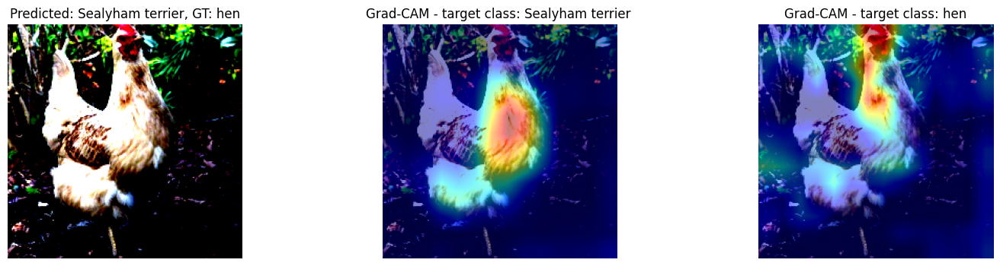

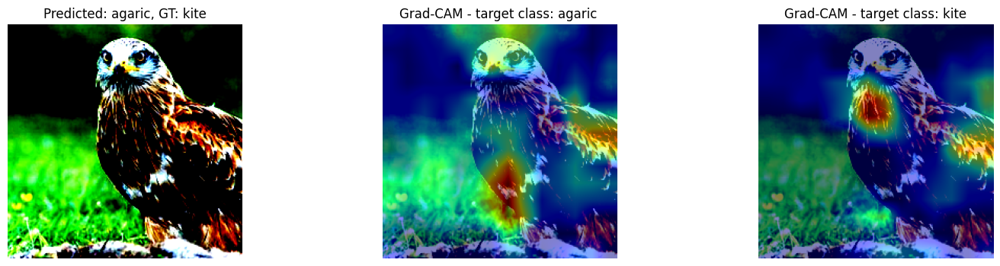

In [97]:
epsilon = 0.01
perturbed_images, noises = pgd_attack(model, images, labels, epsilon, epsilon * 0.1, 40)

outputs = model(perturbed_images) 
predicted = torch.argmax(outputs, dim=1)

plt.figure(figsize=(18, 4))
plt.subplot(1, 3, 1)
orig = perturbed_images[0].cpu().detach().permute(1, 2, 0).numpy()
plt.imshow(orig)
plt.title(f"Predicted: {imagenet_dict[predicted[0].cpu().item()]}, GT: {imagenet_dict[labels[0].cpu().item()]}")
plt.axis("off")

target_class = predicted[0].cpu().item()
cam, _ = grad_cam(model, target_layer, perturbed_images[0].unsqueeze(0), target_class) 
plt.subplot(1, 3, 2)
plt.imshow(orig)
plt.imshow(cam, cmap='jet', alpha = 0.5)
plt.title(f"Grad-CAM - target class: {imagenet_dict[target_class]} ")
plt.axis("off")

target_class = labels[0].cpu().item()
cam, _ = grad_cam(model, target_layer, perturbed_images[0].unsqueeze(0), target_class) 
plt.subplot(1, 3, 3)
plt.imshow(orig)
plt.imshow(cam, cmap='jet', alpha = 0.5)
plt.title(f"Grad-CAM - target class: {imagenet_dict[target_class]}")
plt.axis("off")


plt.figure(figsize=(18, 4))
plt.subplot(1, 3, 1)
orig = perturbed_images[1].cpu().detach().permute(1, 2, 0).numpy()
plt.imshow(orig)
plt.title(f"Predicted: {imagenet_dict[predicted[1].cpu().item()]}, GT: {imagenet_dict[labels[1].cpu().item()]}")
plt.axis("off")

target_class = predicted[1].cpu().item()
cam, _ = grad_cam(model, target_layer, perturbed_images[1].unsqueeze(0), target_class) 
plt.subplot(1, 3, 2)
plt.imshow(orig)
plt.imshow(cam, cmap='jet', alpha = 0.5)
plt.title(f"Grad-CAM - target class: {imagenet_dict[target_class]} ")
plt.axis("off")

target_class = labels[1].cpu().item()
cam, _ = grad_cam(model, target_layer, perturbed_images[1].unsqueeze(0), target_class) 
plt.subplot(1, 3, 3)
plt.imshow(orig)
plt.imshow(cam, cmap='jet', alpha = 0.5)
plt.title(f"Grad-CAM - target class: {imagenet_dict[target_class]}")
plt.axis("off")

(-0.5, 223.5, 223.5, -0.5)

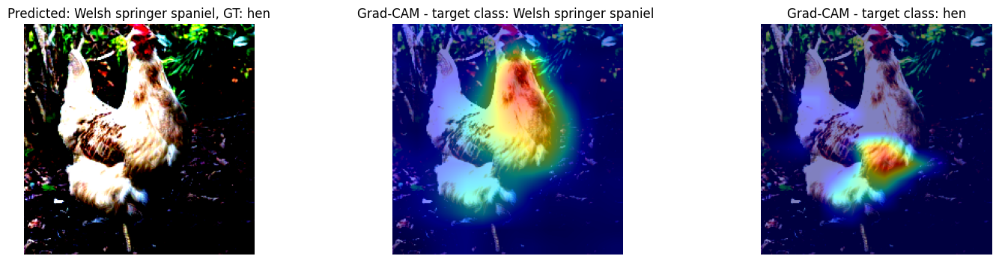

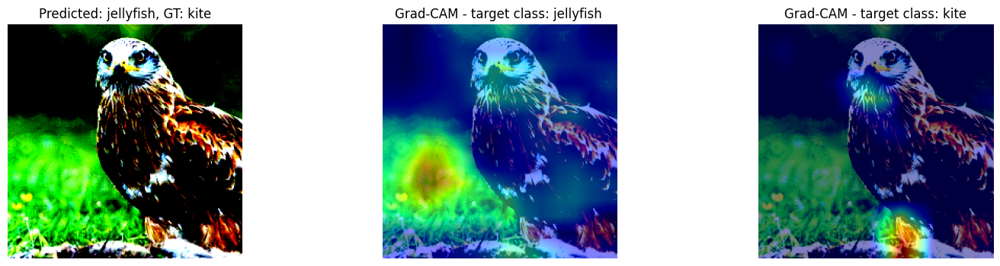

In [98]:
epsilon = 0.08
perturbed_images, noises = pgd_attack(model, images, labels, epsilon, epsilon * 0.1, 40)

outputs = model(perturbed_images) 
predicted = torch.argmax(outputs, dim=1)

plt.figure(figsize=(18, 4))
plt.subplot(1, 3, 1)
orig = perturbed_images[0].cpu().detach().permute(1, 2, 0).numpy()
plt.imshow(orig)
plt.title(f"Predicted: {imagenet_dict[predicted[0].cpu().item()]}, GT: {imagenet_dict[labels[0].cpu().item()]}")
plt.axis("off")

target_class = predicted[0].cpu().item()
cam, _ = grad_cam(model, target_layer, perturbed_images[0].unsqueeze(0), target_class) 
plt.subplot(1, 3, 2)
plt.imshow(orig)
plt.imshow(cam, cmap='jet', alpha = 0.5)
plt.title(f"Grad-CAM - target class: {imagenet_dict[target_class]} ")
plt.axis("off")

target_class = labels[0].cpu().item()
cam, _ = grad_cam(model, target_layer, perturbed_images[0].unsqueeze(0), target_class) 
plt.subplot(1, 3, 3)
plt.imshow(orig)
plt.imshow(cam, cmap='jet', alpha = 0.5)
plt.title(f"Grad-CAM - target class: {imagenet_dict[target_class]}")
plt.axis("off")


plt.figure(figsize=(18, 4))
plt.subplot(1, 3, 1)
orig = perturbed_images[1].cpu().detach().permute(1, 2, 0).numpy()
plt.imshow(orig)
plt.title(f"Predicted: {imagenet_dict[predicted[1].cpu().item()]}, GT: {imagenet_dict[labels[1].cpu().item()]}")
plt.axis("off")

target_class = predicted[1].cpu().item()
cam, _ = grad_cam(model, target_layer, perturbed_images[1].unsqueeze(0), target_class) 
plt.subplot(1, 3, 2)
plt.imshow(orig)
plt.imshow(cam, cmap='jet', alpha = 0.5)
plt.title(f"Grad-CAM - target class: {imagenet_dict[target_class]} ")
plt.axis("off")

target_class = labels[1].cpu().item()
cam, _ = grad_cam(model, target_layer, perturbed_images[1].unsqueeze(0), target_class) 
plt.subplot(1, 3, 3)
plt.imshow(orig)
plt.imshow(cam, cmap='jet', alpha = 0.5)
plt.title(f"Grad-CAM - target class: {imagenet_dict[target_class]}")
plt.axis("off")

(-0.5, 223.5, 223.5, -0.5)

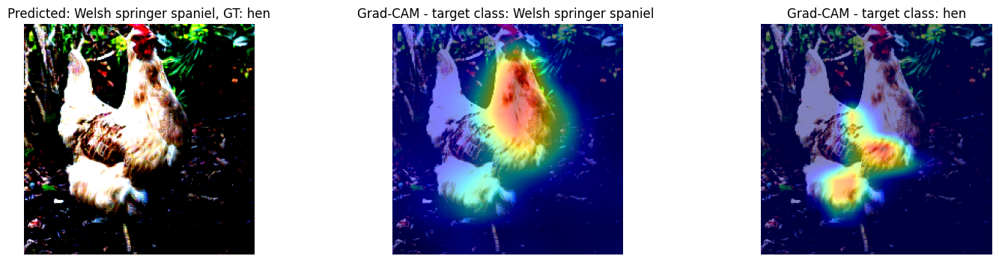

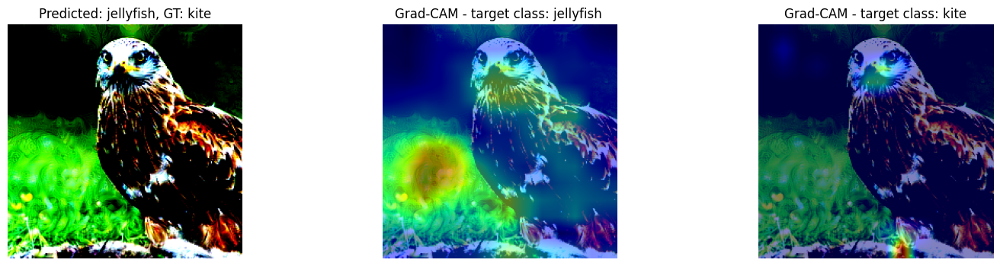

In [99]:
epsilon = 0.15
perturbed_images, noises = pgd_attack(model, images, labels, epsilon, epsilon * 0.1, 40)

outputs = model(perturbed_images) 
predicted = torch.argmax(outputs, dim=1)

plt.figure(figsize=(18, 4))
plt.subplot(1, 3, 1)
orig = perturbed_images[0].cpu().detach().permute(1, 2, 0).numpy()
plt.imshow(orig)
plt.title(f"Predicted: {imagenet_dict[predicted[0].cpu().item()]}, GT: {imagenet_dict[labels[0].cpu().item()]}")
plt.axis("off")

target_class = predicted[0].cpu().item()
cam, _ = grad_cam(model, target_layer, perturbed_images[0].unsqueeze(0), target_class) 
plt.subplot(1, 3, 2)
plt.imshow(orig)
plt.imshow(cam, cmap='jet', alpha = 0.5)
plt.title(f"Grad-CAM - target class: {imagenet_dict[target_class]} ")
plt.axis("off")

target_class = labels[0].cpu().item()
cam, _ = grad_cam(model, target_layer, perturbed_images[0].unsqueeze(0), target_class) 
plt.subplot(1, 3, 3)
plt.imshow(orig)
plt.imshow(cam, cmap='jet', alpha = 0.5)
plt.title(f"Grad-CAM - target class: {imagenet_dict[target_class]}")
plt.axis("off")


plt.figure(figsize=(18, 4))
plt.subplot(1, 3, 1)
orig = perturbed_images[1].cpu().detach().permute(1, 2, 0).numpy()
plt.imshow(orig)
plt.title(f"Predicted: {imagenet_dict[predicted[1].cpu().item()]}, GT: {imagenet_dict[labels[1].cpu().item()]}")
plt.axis("off")

target_class = predicted[1].cpu().item()
cam, _ = grad_cam(model, target_layer, perturbed_images[1].unsqueeze(0), target_class) 
plt.subplot(1, 3, 2)
plt.imshow(orig)
plt.imshow(cam, cmap='jet', alpha = 0.5)
plt.title(f"Grad-CAM - target class: {imagenet_dict[target_class]} ")
plt.axis("off")

target_class = labels[1].cpu().item()
cam, _ = grad_cam(model, target_layer, perturbed_images[1].unsqueeze(0), target_class) 
plt.subplot(1, 3, 3)
plt.imshow(orig)
plt.imshow(cam, cmap='jet', alpha = 0.5)
plt.title(f"Grad-CAM - target class: {imagenet_dict[target_class]}")
plt.axis("off")

In [6]:
def optim_fv(model, target_class, lr, iters):
    input_img = torch.randn(1, 3, 224, 224, requires_grad=True, device='cuda')
    optimizer = torch.optim.Adam([input_img], lr=0.1)
    
    for i in range(iters):
        optimizer.zero_grad()
        output = model(input_img)
        loss = -output[0, target_class]  
        loss.backward()
        optimizer.step()
    return input_img
    


def to_img(tensor):
    img = tensor.cpu().detach().clone().squeeze()
    img = img.permute(1, 2, 0) 
    img = img - img.min()
    img = img / img.max()
    return img




In [15]:
model = models.vgg16(weights=models.VGG16_Weights.IMAGENET1K_V1).cuda()
model.eval()

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

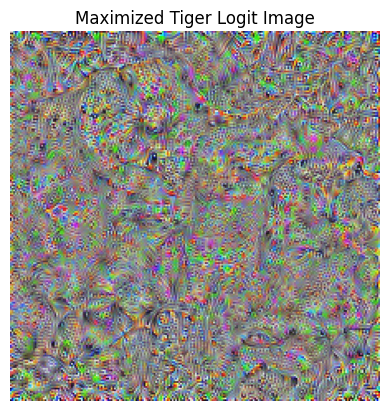

In [7]:
img = optim_fv(model, 293, 0.01, 500)
plt.imshow(to_img(img))
plt.title("Maximized Tiger Logit Image")
plt.axis("off")
plt.show()

In [16]:
def total_variation_loss(img):
    diff1 = torch.abs(img[:, :, :-1, :-1] - img[:, :, :-1, 1:])
    diff2 = torch.abs(img[:, :, :-1, :-1] - img[:, :, 1:, :-1])
    return torch.sum(diff1) + torch.sum(diff2)


def random_shift(img, max_shift=10):
    dx = random.randint(-max_shift, max_shift)
    dy = random.randint(-max_shift, max_shift)
    return torch.roll(img, shifts=(dx, dy), dims=(2, 3))


def optim_fv_reg(model, target_class, lr, iters, seed = 1, tv_weight=1e-5, max_shift=10):
    torch.manual_seed(seed)
    input_img = torch.randn(1, 3, 224, 224, requires_grad=True, device='cuda')
    optimizer = torch.optim.Adam([input_img], lr=lr)
    
    for i in range(iters):
        optimizer.zero_grad()

        shifted_img = random_shift(input_img, max_shift=max_shift)
        output = model(shifted_img)

        class_loss = -output[0, target_class]
        tv_loss = total_variation_loss(shifted_img)
        total_loss = class_loss + tv_weight * tv_loss

        total_loss.backward()
        optimizer.step()

    return input_img


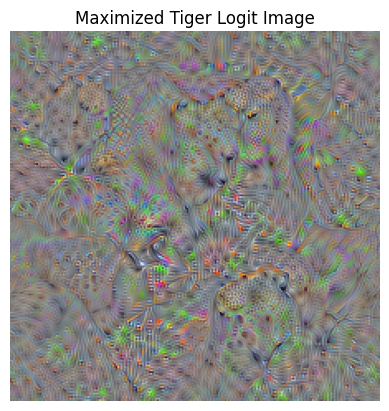

In [25]:
model = models.vgg16(weights=models.VGG16_Weights.IMAGENET1K_V1).cuda()
model.eval()

img = optim_fv_reg(model, 293, 0.05, 500, seed=10, tv_weight=1e-4, max_shift=20)
plt.imshow(to_img(img))
plt.title("Maximized Tiger Logit Image")
plt.axis("off")
plt.show()

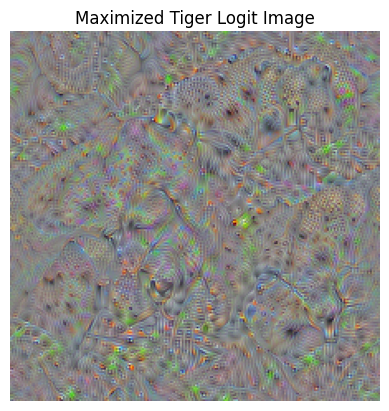

In [26]:
model = models.vgg16(weights=models.VGG16_Weights.IMAGENET1K_V1).cuda()
model.eval()

img = optim_fv_reg(model, 293, 0.05, 500, seed=20, tv_weight=1e-4, max_shift=20)
plt.imshow(to_img(img))
plt.title("Maximized Tiger Logit Image")
plt.axis("off")
plt.show()

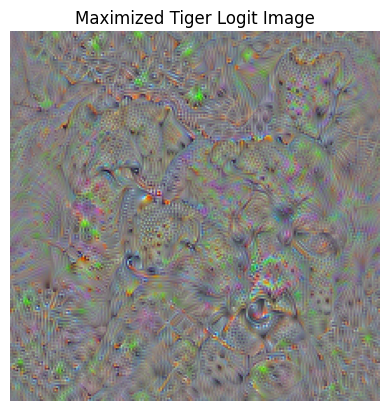

In [29]:
model = models.vgg16(weights=models.VGG16_Weights.IMAGENET1K_V1).cuda()
model.eval()

img = optim_fv_reg(model, 293, 0.05, 500, seed=30, tv_weight=1e-4, max_shift=20)
plt.imshow(to_img(img))
plt.title("Maximized Tiger Logit Image")
plt.axis("off")
plt.show()

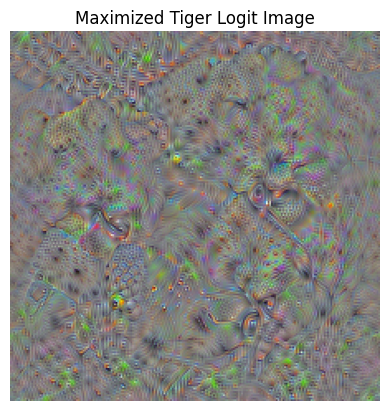

In [30]:
model = models.vgg16(weights=models.VGG16_Weights.IMAGENET1K_V1).cuda()
model.eval()

img = optim_fv_reg(model, 293, 0.05, 500, seed=40, tv_weight=1e-4, max_shift=20)
plt.imshow(to_img(img))
plt.title("Maximized Tiger Logit Image")
plt.axis("off")
plt.show()

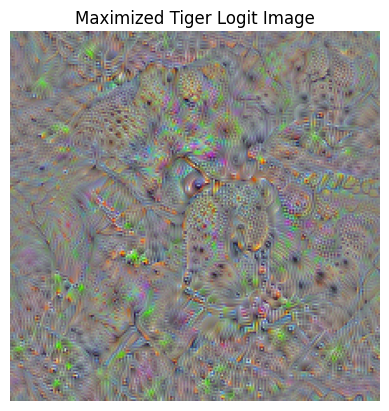

In [31]:
model = models.vgg16(weights=models.VGG16_Weights.IMAGENET1K_V1).cuda()
model.eval()

img = optim_fv_reg(model, 293, 0.05, 500, seed=50, tv_weight=1e-4, max_shift=20)
plt.imshow(to_img(img))
plt.title("Maximized Tiger Logit Image")
plt.axis("off")
plt.show()